In [1]:
from shapely.geometry import Point
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
import datetime as dt

%matplotlib inline

In [2]:
cad_data_derecho_incidents = pd.read_csv('../data/cad_data_derecho_incidents.csv', skiprows = 3)

In [3]:
cad_data_derecho_incidents.head()

,IncidentDate,Location,Latitude1,Longitude1,IncidentTypeDescription1
0,5/3/2020 4:31:07 PM,901 KENWICK CT W,36.046877,-86.962526,ELECTRICAL HAZARD
1,5/3/2020 4:32:18 PM,8036 ARBOR DR,36.082491,-86.940680,ELECTRICAL HAZARD
2,5/3/2020 4:32:23 PM,119 DUE WEST AV E,36.248029,-86.716875,NOT ALERT COPD
3,5/3/2020 4:33:04 PM,630 GALLATIN PKE S,36.256491,-86.714817,ABDOMINAL PAIN
4,5/3/2020 4:33:52 PM,615 W HILLWOOD DR,36.129690,-86.879834,ELECTRICAL HAZARD


In [4]:
cad_data_tornado_incidents = pd.read_csv('../data/cad_data_tornado_incidents.csv', skiprows = 3)

In [5]:
cad_data_tornado_incidents.head()

,IncidentDate,Location,Latitude1,Longitude1,IncidentTypeDescription1
0,3/3/2020 12:36:34 AM,6205 COCKRILL BEND CIR,36.182002,-86.894052,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
1,3/3/2020 12:37:24 AM,7337 COCKRILL BEND BLVD,36.175666,-86.894978,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
2,3/3/2020 12:38:17 AM,110 TUNE AIRPORT DR,36.179299,-86.883727,STRUCTURE FIRE COMMERCIAL INDUSTRIAL
3,3/3/2020 12:39:40 AM,555 MARRIOTT DR,36.151108,-86.689921,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
4,3/3/2020 12:39:42 AM,1414 COUNTY HOSPITAL RD,36.177926,-86.845934,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD


In [6]:
nine11_phone_calls_derecho = pd.read_csv('../data/nine11_phone_calls_derecho.csv')

In [7]:
nine11_phone_calls_derecho.head()

,Seizure DateTime,CallTypeId,ALI Latitude,ALI Longitude,Cell Tower Address
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE


In [8]:
nine11_phone_calls_tornado = pd.read_csv('../data/nine11_phone_calls_tornado.csv')

In [9]:
nine11_phone_calls_tornado.head()

,Seizure DateTime,CallTypeId,ALI Latitude,ALI Longitude,Cell Tower Address
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector
3,3/3/2020 0:36,911 Calls,NaN,NaN,526 FOUNDRY DR
4,3/3/2020 0:36,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N


In [10]:
cad_data_derecho_incidents.columns

Index(['IncidentDate', 'Location', 'Latitude1', 'Longitude1',
       'IncidentTypeDescription1'],
      dtype='object')

In [11]:
cad_data_derecho_incidents.columns = ['incident_date', 'location', 'lat', 'lng','incident_type_desc']
cad_data_derecho_incidents.head(2)

,incident_date,location,lat,lng,incident_type_desc
0,5/3/2020 4:31:07 PM,901 KENWICK CT W,36.046877,-86.962526,ELECTRICAL HAZARD
1,5/3/2020 4:32:18 PM,8036 ARBOR DR,36.082491,-86.940680,ELECTRICAL HAZARD


In [12]:
cad_data_derecho_incidents.columns

Index(['incident_date', 'location', 'lat', 'lng', 'incident_type_desc'], dtype='object')

In [13]:
cad_data_tornado_incidents.columns

Index(['IncidentDate', 'Location', 'Latitude1', 'Longitude1',
       'IncidentTypeDescription1'],
      dtype='object')

In [14]:
cad_data_tornado_incidents.columns = ['incident_date', 'location', 'lat', 'lng', 'incident_type_desc']
cad_data_tornado_incidents.head(2)

,incident_date,location,lat,lng,incident_type_desc
0,3/3/2020 12:36:34 AM,6205 COCKRILL BEND CIR,36.182002,-86.894052,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
1,3/3/2020 12:37:24 AM,7337 COCKRILL BEND BLVD,36.175666,-86.894978,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD


In [15]:
nine11_phone_calls_derecho.columns

Index(['Seizure DateTime', 'CallTypeId', 'ALI Latitude', 'ALI Longitude',
       'Cell Tower Address'],
      dtype='object')

In [16]:
nine11_phone_calls_derecho.columns = ['seizure_date_time', 'call_type_id', 'lat', 'lng', 'cell_tower_address']
nine11_phone_calls_derecho.head(2)

,seizure_date_time,call_type_id,lat,lng,cell_tower_address
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE


In [17]:
nine11_phone_calls_derecho.columns

Index(['seizure_date_time', 'call_type_id', 'lat', 'lng',
       'cell_tower_address'],
      dtype='object')

In [18]:
nine11_phone_calls_tornado.columns = ['seizure_date_time', 'call_type_id', 'lat', 'lng', 'cell_tower_address']
nine11_phone_calls_tornado.head(2)

,seizure_date_time,call_type_id,lat,lng,cell_tower_address
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE


In [19]:
zip_codes = gpd.read_file('../data/zip_codes.geojson')
print(zip_codes.crs)
zip_codes.head( )

epsg:4326


,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37216,3,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37027,11,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ..."
4,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."


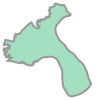

In [20]:
zip_codes.loc[0, 'geometry']

In [21]:
print(zip_codes.loc[0, 'geometry'])

MULTIPOLYGON (((-86.68724897141 36.318212121092, -86.687216475338 36.318210560887, -86.687181702435 36.318208780693, -86.68714696276101 36.318206917893, -86.68711218725601 36.318205000347, -86.687077445444 36.318202972151, -86.687042702928 36.318200862685, -86.68703469075101 36.318200362824, -86.687007959928 36.318198697129, -86.68697325063 36.318196422067, -86.686938539918 36.318194065167, -86.68690382778099 36.318191625285, -86.68686914958001 36.318189102792, -86.68683443743301 36.318186498074, -86.6867997571 36.318183810757, -86.686765111412 36.318181040826, -86.686730430357 36.318178188106, -86.686695782299 36.318175225883, -86.68666116771 36.318172208522, -86.686626552408 36.318169108746, -86.686591935688 36.318165926561, -86.68655731872499 36.318162634491, -86.686522735235 36.318159287854, -86.68648815149901 36.318155830759, -86.686453600524 36.318152318529, -86.68641904813001 36.31814872389, -86.68638449549 36.318145018792, -86.686349976324 36.318141259129, -86.68631549014999 36

<AxesSubplot:>

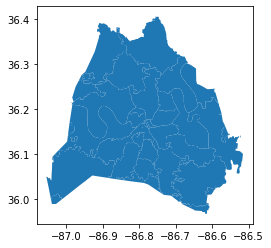

In [22]:
zip_codes.plot()

In [23]:
nine11_phone_calls_tornado.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 475 entries, 0 to 474
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   seizure_date_time   475 non-null    object 
 1   call_type_id        475 non-null    object 
 2   lat                 450 non-null    float64
 3   lng                 450 non-null    float64
 4   cell_tower_address  468 non-null    object 
dtypes: float64(2), object(3)
memory usage: 18.7+ KB


In [24]:
nine11_phone_calls_tornado['geometry'] = nine11_phone_calls_tornado.apply(lambda x: Point((float(x.lng), 
                                                         float(x.lat))), 
                                        axis=1)
nine11_phone_calls_tornado.head(3)

,seizure_date_time,call_type_id,lat,lng,cell_tower_address,geometry
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (-86.665779 36.072708)
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE,POINT (-86.841904 36.159634)
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector,POINT (-86.708862 36.264153)


In [25]:
nash_map = folium.Map(location = [36.1612, -86.7775], zoom_start = 12)

In [26]:
nash_map

In [27]:
nine11_phone_calls_tornado_nonan = nine11_phone_calls_tornado.dropna(how='any',axis=0) 

In [28]:
nine11_phone_calls_tornado_nonan

,seizure_date_time,call_type_id,lat,lng,cell_tower_address,geometry
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (-86.665779 36.072708)
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE,POINT (-86.841904 36.159634)
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector,POINT (-86.708862 36.264153)
4,3/3/2020 0:36,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N,POINT (-86.72107700000001 36.233467)
5,3/3/2020 0:37,911 Calls,36.149032,-86.795747,WIRELESS CALLER,POINT (-86.79574699999999 36.149032)
...,...,...,...,...,...,...
470,3/3/2020 4:54,911 Calls,36.142552,-86.635330,WIRELESS CALLER,POINT (-86.63533000000001 36.142552)
471,3/3/2020 4:54,911 Calls,36.189415,-86.813557,WIRELESS CALLER,POINT (-86.81355699999999 36.189415)
472,3/3/2020 4:55,911 Calls,36.223534,-86.757874,WIRELESS CALLER,POINT (-86.757874 36.223534)
473,3/3/2020 4:56,911 Calls,36.168398,-86.783774,600 DR MARTIN L KING JR BLVD - NE,POINT (-86.78377399999999 36.168398)


In [29]:
i = 0
for row_index, row_values in nine11_phone_calls_tornado_nonan.iterrows():
    if i <3: 
        print('index is', row_index)
        print('values are:')
        print(' ')
        print(row_values)
        print('------------------------- ')
        i+=1

index is 0
values are:
 
seizure_date_time                    3/3/2020 0:34
call_type_id                             911 Calls
lat                                        36.0727
lng                                       -86.6658
cell_tower_address      620 Richards RD - N Sector
geometry              POINT (-86.665779 36.072708)
Name: 0, dtype: object
------------------------- 
index is 1
values are:
 
seizure_date_time                    3/3/2020 0:36
call_type_id                             911 Calls
lat                                        36.1596
lng                                       -86.8419
cell_tower_address          4507D KENTUCKY AV - SE
geometry              POINT (-86.841904 36.159634)
Name: 1, dtype: object
------------------------- 
index is 2
values are:
 
seizure_date_time                    3/3/2020 0:36
call_type_id                             911 Calls
lat                                        36.2642
lng                                       -86.7089
cell_towe

In [30]:
nine11_phone_calls_tornado_nonan.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 450 entries, 0 to 474
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   seizure_date_time   450 non-null    object 
 1   call_type_id        450 non-null    object 
 2   lat                 450 non-null    float64
 3   lng                 450 non-null    float64
 4   cell_tower_address  450 non-null    object 
 5   geometry            450 non-null    object 
dtypes: float64(2), object(4)
memory usage: 24.6+ KB


In [31]:
nash_map_tornado_911 = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

folium.GeoJson(zip_codes).add_to(nash_map_tornado_911)

for row_index, row_values in nine11_phone_calls_tornado_nonan.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['seizure_date_time','cell_tower_address']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(nash_map_tornado_911)
nash_map_tornado_911.save('../maps/nash_map_tornado_911.html')

nash_map_tornado_911

In [32]:
cluster_map_nash_tornado_911 = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

marker_cluster = MarkerCluster().add_to(cluster_map_nash_tornado_911)

folium.GeoJson(zip_codes).add_to(cluster_map_nash_tornado_911)

for row_index, row_values in nine11_phone_calls_tornado_nonan.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['seizure_date_time','cell_tower_address']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

    
cluster_map_nash_tornado_911.save('../maps/cluster_map_nash_tornado_911.html')

cluster_map_nash_tornado_911

In [33]:
cad_data_tornado_incidents.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260 entries, 0 to 259
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   incident_date       260 non-null    object 
 1   location            260 non-null    object 
 2   lat                 260 non-null    float64
 3   lng                 260 non-null    float64
 4   incident_type_desc  260 non-null    object 
dtypes: float64(2), object(3)
memory usage: 10.3+ KB


In [34]:
nash_map_tornado_cad = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

folium.GeoJson(zip_codes).add_to(nash_map_tornado_cad)

for row_index, row_values in cad_data_tornado_incidents.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['incident_date', 'location', 'lat', 'lng', 'incident_type_desc']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(nash_map_tornado_cad)
nash_map_tornado_cad.save('../maps/nash_map_tornado_cad.html')

nash_map_tornado_cad

In [35]:
cluster_nash_map_tornado_cad = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

marker_cluster = MarkerCluster().add_to(cluster_nash_map_tornado_cad)

folium.GeoJson(zip_codes).add_to(cluster_nash_map_tornado_cad)

for row_index, row_values in cad_data_tornado_incidents.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['incident_date', 'location', 'lat', 'lng', 'incident_type_desc']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

    
cluster_nash_map_tornado_cad.save('../maps/cluster_nash_map_tornado_cad.html')

cluster_nash_map_tornado_cad

In [36]:
nine11_phone_calls_derecho.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1549 entries, 0 to 1548
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   seizure_date_time   1549 non-null   object 
 1   call_type_id        1549 non-null   object 
 2   lat                 1483 non-null   float64
 3   lng                 1483 non-null   float64
 4   cell_tower_address  1525 non-null   object 
dtypes: float64(2), object(3)
memory usage: 60.6+ KB


In [37]:
nine11_phone_calls_derecho_nonan = nine11_phone_calls_derecho.dropna(how='any',axis=0)

In [38]:
nine11_phone_calls_derecho_nonan.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1483 entries, 0 to 1547
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   seizure_date_time   1483 non-null   object 
 1   call_type_id        1483 non-null   object 
 2   lat                 1483 non-null   float64
 3   lng                 1483 non-null   float64
 4   cell_tower_address  1483 non-null   object 
dtypes: float64(2), object(3)
memory usage: 69.5+ KB


In [39]:
nash_map_derecho_911 = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

folium.GeoJson(zip_codes).add_to(nash_map_derecho_911)

for row_index, row_values in nine11_phone_calls_derecho_nonan.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['seizure_date_time','cell_tower_address']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(nash_map_derecho_911)
nash_map_derecho_911.save('../maps/nash_map_derecho_911.html')

nash_map_derecho_911

In [40]:
cluster_nash_map_derecho_911 = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

marker_cluster = MarkerCluster().add_to(cluster_nash_map_derecho_911)

folium.GeoJson(zip_codes).add_to(cluster_nash_map_derecho_911)

for row_index, row_values in nine11_phone_calls_derecho_nonan.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['seizure_date_time','cell_tower_address']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

    
cluster_nash_map_derecho_911.save('../maps/cluster_nash_map_derecho_911.html')

cluster_nash_map_derecho_911

In [41]:
nash_map_derecho_cad = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

folium.GeoJson(zip_codes).add_to(nash_map_derecho_cad)

for row_index, row_values in cad_data_derecho_incidents.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['incident_date', 'location', 'lat', 'lng', 'incident_type_desc']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(nash_map_derecho_cad)
nash_map_derecho_cad.save('../maps/nash_map_derecho_cad.html')

nash_map_derecho_cad

In [42]:
cluster_nash_map_derecho_cad = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

marker_cluster = MarkerCluster().add_to(cluster_nash_map_derecho_cad)

folium.GeoJson(zip_codes).add_to(cluster_nash_map_derecho_cad)

for row_index, row_values in cad_data_derecho_incidents.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['incident_date', 'location', 'lat', 'lng', 'incident_type_desc']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

    
cluster_nash_map_derecho_cad.save('../maps/cluster_nash_map_derecho_cad.html')

cluster_nash_map_derecho_cad

In [43]:
Metro_Nashville_Police_Department_Incidents = pd.read_csv('../data/Metro_Nashville_Police_Department_Incidents.csv')

In [44]:
Metro_Nashville_Police_Department_Incidents.head(2)

,Primary Key,Incident Number,Report Type,Report Type Description,Incident Status Code,Incident Status Description,Investigation Status,Incident Occurred,Incident Reported,Incident Location,...,Weapon Description,Victim Number,Domestic Related,Victim Type,Victim Description,Victim Gender,Victim Race,Victim Ethnicity,Victim County Resident,Mapped Location
0,20140395371_11,20140395371,D,DISPATCHED,O,OPEN,Open,04/21/2014 10:00:00 AM,04/25/2014 03:57:00 PM,1300 ANTIOCH PIKE,...,NONE,1,False,B,BUSINESS,NaN,NaN,NaN,NaN,NaN
1,20200601877_11,20200601877,T,NaN,O,OPEN,Open,09/08/2020 03:37:00 PM,09/19/2020 12:35:00 PM,ABBOTT MARTIN RD,...,NONE,1,False,B,BUSINESS,NaN,NaN,NaN,NaN,POINT (-86.82 36.11)


In [45]:
nash_police_incidents = Metro_Nashville_Police_Department_Incidents

In [46]:
nash_police_incidents.columns

Index(['Primary Key', 'Incident Number', 'Report Type',
       'Report Type Description', 'Incident Status Code',
       'Incident Status Description', 'Investigation Status',
       'Incident Occurred', 'Incident Reported', 'Incident Location',
       'Latitude', 'Longitude', 'ZIP Code', 'RPA', 'Zone', 'Location Code',
       'Location Description', 'Offense Number', 'Offense NIBRS',
       'Offense Description', 'Weapon Primary', 'Weapon Description',
       'Victim Number', 'Domestic Related', 'Victim Type',
       'Victim Description', 'Victim Gender', 'Victim Race',
       'Victim Ethnicity', 'Victim County Resident', 'Mapped Location'],
      dtype='object')

In [47]:
nash_police_incidents = nash_police_incidents.drop(columns = ['Incident Status Code','Incident Status Description',
                                                              'Investigation Status','RPA','Zone','Offense Number',
                                                              'Weapon Primary', 'Weapon Description','Victim Number',
                                                              'Domestic Related', 'Victim Type','Victim Description',
                                                              'Victim Gender', 'Victim Race','Victim Ethnicity',
                                                              'Victim County Resident'])

In [48]:
nash_police_incidents.head(2)

,Primary Key,Incident Number,Report Type,Report Type Description,Incident Occurred,Incident Reported,Incident Location,Latitude,Longitude,ZIP Code,Location Code,Location Description,Offense NIBRS,Offense Description,Mapped Location
0,20140395371_11,20140395371,D,DISPATCHED,04/21/2014 10:00:00 AM,04/25/2014 03:57:00 PM,1300 ANTIOCH PIKE,NaN,NaN,NaN,8.0,"DEPARTMENT, DISCOUNT STORE",26B,FRAUD - ILLEG USE OF CREDIT CARDS,NaN
1,20200601877_11,20200601877,T,NaN,09/08/2020 03:37:00 PM,09/19/2020 12:35:00 PM,ABBOTT MARTIN RD,36.11,-86.82,NaN,55.0,Shopping Mall,23C,SHOPLIFTING,POINT (-86.82 36.11)


In [49]:
nash_police_incidents.columns

Index(['Primary Key', 'Incident Number', 'Report Type',
       'Report Type Description', 'Incident Occurred', 'Incident Reported',
       'Incident Location', 'Latitude', 'Longitude', 'ZIP Code',
       'Location Code', 'Location Description', 'Offense NIBRS',
       'Offense Description', 'Mapped Location'],
      dtype='object')

In [50]:
nash_police_incidents = nash_police_incidents.rename(columns = {'Primary Key': 'primary_key',
                                                                'Incident Number':'incident_number',
                                                                'Report Type':'report_type',
                                                                'Report Type Description':'report_type_desc',
                                                                'Incident Occurred':'incident_occurred',
                                                                'Incident Reported':'incident_reported',
                                                                'Incident Location':'incident_location',
                                                                'Latitude':'lat','Longitude':'lng','ZIP Code':'zip',
                                                                'Location Code':'location_code',
                                                                'Location Description':'location_desc',
                                                                'Offense NIBRS':'offense_NIBRS',
                                                                'Offense Description':'offense_desc',
                                                                'Mapped Location':'mapped_location'})
nash_police_incidents.head(2)

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location
0,20140395371_11,20140395371,D,DISPATCHED,04/21/2014 10:00:00 AM,04/25/2014 03:57:00 PM,1300 ANTIOCH PIKE,NaN,NaN,NaN,8.0,"DEPARTMENT, DISCOUNT STORE",26B,FRAUD - ILLEG USE OF CREDIT CARDS,NaN
1,20200601877_11,20200601877,T,NaN,09/08/2020 03:37:00 PM,09/19/2020 12:35:00 PM,ABBOTT MARTIN RD,36.11,-86.82,NaN,55.0,Shopping Mall,23C,SHOPLIFTING,POINT (-86.82 36.11)


In [51]:
nash_police_inc_week = nash_police_incidents

In [52]:
nash_police_inc_week['incident_occurred'] = pd.to_datetime(nash_police_incidents['incident_occurred'],
                                                           format= '%m/%d/%Y %I:%M:%S %p')

In [53]:
nash_police_inc_week = nash_police_incidents[(nash_police_incidents['incident_occurred'] > '02/21/2020') &
                                              (nash_police_incidents['incident_occurred'] <= '03/11/2020')]

In [54]:
nash_police_inc_week.head()

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location
14,20200163017_11,20200163017,D,DISPATCHED,2020-03-06 06:00:00,03/06/2020 06:25:00 PM,HARDING PL,36.090,-86.690,NaN,20.0,"PARKING LOT, GARAGE",290,DAMAGE PROP - PRIVATE,POINT (-86.69 36.09)
46,20200137333_11,20200137333,T,NaN,2020-02-26 10:00:00,02/26/2020 11:13:00 AM,CHARLOTTE PIKE,36.140,-86.880,NaN,26.0,SPECIALTY STORE,23C,SHOPLIFTING,POINT (-86.88 36.14)
334,20200129658_11,20200129658,D,DISPATCHED,2020-02-23 06:00:00,02/23/2020 06:20:00 AM,I 24 W,36.090,-86.700,NaN,13.0,"HIGHWAY, ROAD, ALLEY",13A,INTENTIONAL AGGRAVATED ASSAULT,POINT (-86.7 36.09)
552,20200137607_22,20200137607,D,DISPATCHED,2020-02-26 13:00:00,02/26/2020 04:06:00 PM,14TH AVE N,36.180,-86.810,NaN,13.0,"HIGHWAY, ROAD, ALLEY",520,"WEAPON OFFENSE, CRIMINAL ATTEMPT",POINT (-86.81 36.18)
833,20200169387_22,20200169387,D,DISPATCHED,2020-03-08 20:00:00,03/08/2020 10:05:00 PM,1300 BENDING CREEK DR,36.019,-86.685,37013.0,22.0,"RESIDENCE, HOME",13A,INTENTIONAL AGGRAVATED ASSAULT,POINT (-86.685 36.019)


In [55]:
nash_police_inc_week = nash_police_incidents[(nash_police_incidents['incident_occurred'] > '02/21/2020') &
                                              (nash_police_incidents['incident_occurred'] <= '03/11/2020')]

In [56]:
nash_police_inc_week.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5825 entries, 14 to 936869
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   primary_key        5825 non-null   object        
 1   incident_number    5825 non-null   int64         
 2   report_type        5825 non-null   object        
 3   report_type_desc   5453 non-null   object        
 4   incident_occurred  5825 non-null   datetime64[ns]
 5   incident_reported  5825 non-null   object        
 6   incident_location  5809 non-null   object        
 7   lat                5793 non-null   float64       
 8   lng                5793 non-null   float64       
 9   zip                3053 non-null   float64       
 10  location_code      5825 non-null   float64       
 11  location_desc      5825 non-null   object        
 12  offense_NIBRS      5823 non-null   object        
 13  offense_desc       5825 non-null   object        
 14  mappe

In [57]:
nash_police_inc_week.head()

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location
14,20200163017_11,20200163017,D,DISPATCHED,2020-03-06 06:00:00,03/06/2020 06:25:00 PM,HARDING PL,36.090,-86.690,NaN,20.0,"PARKING LOT, GARAGE",290,DAMAGE PROP - PRIVATE,POINT (-86.69 36.09)
46,20200137333_11,20200137333,T,NaN,2020-02-26 10:00:00,02/26/2020 11:13:00 AM,CHARLOTTE PIKE,36.140,-86.880,NaN,26.0,SPECIALTY STORE,23C,SHOPLIFTING,POINT (-86.88 36.14)
334,20200129658_11,20200129658,D,DISPATCHED,2020-02-23 06:00:00,02/23/2020 06:20:00 AM,I 24 W,36.090,-86.700,NaN,13.0,"HIGHWAY, ROAD, ALLEY",13A,INTENTIONAL AGGRAVATED ASSAULT,POINT (-86.7 36.09)
552,20200137607_22,20200137607,D,DISPATCHED,2020-02-26 13:00:00,02/26/2020 04:06:00 PM,14TH AVE N,36.180,-86.810,NaN,13.0,"HIGHWAY, ROAD, ALLEY",520,"WEAPON OFFENSE, CRIMINAL ATTEMPT",POINT (-86.81 36.18)
833,20200169387_22,20200169387,D,DISPATCHED,2020-03-08 20:00:00,03/08/2020 10:05:00 PM,1300 BENDING CREEK DR,36.019,-86.685,37013.0,22.0,"RESIDENCE, HOME",13A,INTENTIONAL AGGRAVATED ASSAULT,POINT (-86.685 36.019)


In [58]:
nash_police_inc_week.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5825 entries, 14 to 936869
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   primary_key        5825 non-null   object        
 1   incident_number    5825 non-null   int64         
 2   report_type        5825 non-null   object        
 3   report_type_desc   5453 non-null   object        
 4   incident_occurred  5825 non-null   datetime64[ns]
 5   incident_reported  5825 non-null   object        
 6   incident_location  5809 non-null   object        
 7   lat                5793 non-null   float64       
 8   lng                5793 non-null   float64       
 9   zip                3053 non-null   float64       
 10  location_code      5825 non-null   float64       
 11  location_desc      5825 non-null   object        
 12  offense_NIBRS      5823 non-null   object        
 13  offense_desc       5825 non-null   object        
 14  mappe

In [59]:
nash_police_inc_week.zip.value_counts()

37013.0    306
37207.0    303
37115.0    282
37211.0    270
37203.0    246
37208.0    203
37209.0    171
37206.0    160
37210.0    151
37076.0    136
37217.0    122
37214.0    120
37218.0     80
37201.0     78
37216.0     69
37221.0     53
37219.0     44
37204.0     42
37205.0     32
37138.0     32
37215.0     20
37027.0     20
37072.0     19
37228.0     19
37212.0     18
37213.0     16
37220.0     13
37189.0     12
37080.0     10
37135.0      4
37086.0      1
37015.0      1
Name: zip, dtype: int64

In [60]:
nash_police_inc_week.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5825 entries, 14 to 936869
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   primary_key        5825 non-null   object        
 1   incident_number    5825 non-null   int64         
 2   report_type        5825 non-null   object        
 3   report_type_desc   5453 non-null   object        
 4   incident_occurred  5825 non-null   datetime64[ns]
 5   incident_reported  5825 non-null   object        
 6   incident_location  5809 non-null   object        
 7   lat                5793 non-null   float64       
 8   lng                5793 non-null   float64       
 9   zip                3053 non-null   float64       
 10  location_code      5825 non-null   float64       
 11  location_desc      5825 non-null   object        
 12  offense_NIBRS      5823 non-null   object        
 13  offense_desc       5825 non-null   object        
 14  mappe

In [61]:
nash_police_inc_week.head(2)

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location
14,20200163017_11,20200163017,D,DISPATCHED,2020-03-06 06:00:00,03/06/2020 06:25:00 PM,HARDING PL,36.09,-86.69,NaN,20.0,"PARKING LOT, GARAGE",290,DAMAGE PROP - PRIVATE,POINT (-86.69 36.09)
46,20200137333_11,20200137333,T,NaN,2020-02-26 10:00:00,02/26/2020 11:13:00 AM,CHARLOTTE PIKE,36.14,-86.88,NaN,26.0,SPECIALTY STORE,23C,SHOPLIFTING,POINT (-86.88 36.14)


In [62]:
nash_police_inc_week = nash_police_incidents[(nash_police_incidents['incident_occurred'] > '02/21/2020') &
                                              (nash_police_incidents['incident_occurred'] <= '03/11/2020')]

In [63]:
nash_police_inc_week.head()

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location
14,20200163017_11,20200163017,D,DISPATCHED,2020-03-06 06:00:00,03/06/2020 06:25:00 PM,HARDING PL,36.090,-86.690,NaN,20.0,"PARKING LOT, GARAGE",290,DAMAGE PROP - PRIVATE,POINT (-86.69 36.09)
46,20200137333_11,20200137333,T,NaN,2020-02-26 10:00:00,02/26/2020 11:13:00 AM,CHARLOTTE PIKE,36.140,-86.880,NaN,26.0,SPECIALTY STORE,23C,SHOPLIFTING,POINT (-86.88 36.14)
334,20200129658_11,20200129658,D,DISPATCHED,2020-02-23 06:00:00,02/23/2020 06:20:00 AM,I 24 W,36.090,-86.700,NaN,13.0,"HIGHWAY, ROAD, ALLEY",13A,INTENTIONAL AGGRAVATED ASSAULT,POINT (-86.7 36.09)
552,20200137607_22,20200137607,D,DISPATCHED,2020-02-26 13:00:00,02/26/2020 04:06:00 PM,14TH AVE N,36.180,-86.810,NaN,13.0,"HIGHWAY, ROAD, ALLEY",520,"WEAPON OFFENSE, CRIMINAL ATTEMPT",POINT (-86.81 36.18)
833,20200169387_22,20200169387,D,DISPATCHED,2020-03-08 20:00:00,03/08/2020 10:05:00 PM,1300 BENDING CREEK DR,36.019,-86.685,37013.0,22.0,"RESIDENCE, HOME",13A,INTENTIONAL AGGRAVATED ASSAULT,POINT (-86.685 36.019)


In [64]:
police_week_before_tornado = nash_police_incidents[(nash_police_incidents['incident_occurred'] >= '02/25/2020') &
                                              (nash_police_incidents['incident_occurred'] < '03/03/2020')]

In [65]:
police_week_before_tornado.head()

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location
46,20200137333_11,20200137333,T,NaN,2020-02-26 10:00:00,02/26/2020 11:13:00 AM,CHARLOTTE PIKE,36.140,-86.880,NaN,26.0,SPECIALTY STORE,23C,SHOPLIFTING,POINT (-86.88 36.14)
552,20200137607_22,20200137607,D,DISPATCHED,2020-02-26 13:00:00,02/26/2020 04:06:00 PM,14TH AVE N,36.180,-86.810,NaN,13.0,"HIGHWAY, ROAD, ALLEY",520,"WEAPON OFFENSE, CRIMINAL ATTEMPT",POINT (-86.81 36.18)
898,20200425781_11,20200425781,D,DISPATCHED,2020-02-25 03:30:00,06/25/2020 04:28:00 AM,200 HICKORY TRACE DR,36.046,-86.718,37211.0,90.0,APARTMENT,13B,SIMPLE ASSLT,POINT (-86.718 36.046)
1201,20200142857_12,20200142857,D,DISPATCHED,2020-02-28 11:55:00,02/28/2020 01:32:00 PM,KENTUCKY AVE,36.160,-86.840,NaN,22.0,"RESIDENCE, HOME",220,BURGLARY- AGGRAVATED,POINT (-86.84 36.16)
2727,20200142857_11,20200142857,D,DISPATCHED,2020-02-28 11:55:00,02/28/2020 01:32:00 PM,KENTUCKY AVE,36.160,-86.840,NaN,22.0,"RESIDENCE, HOME",220,BURGLARY- AGGRAVATED,POINT (-86.84 36.16)


In [66]:
police_week_before_tornado.shape

(2111, 15)

In [68]:
police_week_after_tornado = nash_police_incidents[(nash_police_incidents['incident_occurred'] >= '3/4/2020') &
                                              (nash_police_incidents['incident_occurred'] <= '3/11/2020')]

In [69]:
police_week_after_tornado.shape

(2105, 15)

In [70]:
police_week_after_derecho = nash_police_incidents[(nash_police_incidents['incident_occurred'] >= '05/04/2020') &
                                              (nash_police_incidents['incident_occurred'] <= '05/10/2020')]

In [71]:
police_week_after_derecho.shape

(1651, 15)

In [72]:
police_week_before_derecho = nash_police_incidents[(nash_police_incidents['incident_occurred'] >= '04/26/2020') &
                                              (nash_police_incidents['incident_occurred'] <= '05/02/2020')]

In [73]:
police_week_before_derecho.shape

(1771, 15)

In [74]:
police_week_after_derecho.head(2)

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location
233,20200326943_11,20200326943,D,DISPATCHED,2020-05-04 16:17:00,05/08/2020 03:33:00 PM,LUCAS LN,36.20,-86.77,NaN,8.0,"DEPARTMENT, DISCOUNT STORE",23C,SHOPLIFTING,POINT (-86.77 36.2)
439,20200333656_11,20200333656,D,DISPATCHED,2020-05-04 09:00:00,05/11/2020 05:06:00 PM,OLIVE CIR,36.09,-86.66,NaN,22.0,"RESIDENCE, HOME",23D,LARC - FROM BLDG,POINT (-86.66 36.09)


In [75]:
police_week_after_derecho.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1651 entries, 233 to 936821
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   primary_key        1651 non-null   object        
 1   incident_number    1651 non-null   int64         
 2   report_type        1651 non-null   object        
 3   report_type_desc   1471 non-null   object        
 4   incident_occurred  1651 non-null   datetime64[ns]
 5   incident_reported  1651 non-null   object        
 6   incident_location  1651 non-null   object        
 7   lat                1641 non-null   float64       
 8   lng                1641 non-null   float64       
 9   zip                871 non-null    float64       
 10  location_code      1651 non-null   float64       
 11  location_desc      1651 non-null   object        
 12  offense_NIBRS      1651 non-null   object        
 13  offense_desc       1651 non-null   object        
 14  mapp

arts_grants['Location'] = arts_grants['Mapped Location'].str.split(' ').str[0]
df['Date'] = df['DateTime'].dt.strftime('%d/%m/%Y')
before['date'] = before['incident_o'].dt.strftime('%Y/%m/%d')


In [76]:
police_week_after_derecho.head(2)

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location
233,20200326943_11,20200326943,D,DISPATCHED,2020-05-04 16:17:00,05/08/2020 03:33:00 PM,LUCAS LN,36.20,-86.77,NaN,8.0,"DEPARTMENT, DISCOUNT STORE",23C,SHOPLIFTING,POINT (-86.77 36.2)
439,20200333656_11,20200333656,D,DISPATCHED,2020-05-04 09:00:00,05/11/2020 05:06:00 PM,OLIVE CIR,36.09,-86.66,NaN,22.0,"RESIDENCE, HOME",23D,LARC - FROM BLDG,POINT (-86.66 36.09)


In [77]:
nine11_phone_calls_derecho.shape

(1549, 5)

In [78]:
before_after_derecho_df = nash_police_incidents[(nash_police_incidents['incident_occurred'] >= '04/26/2020') &
                                              (nash_police_incidents['incident_occurred'] < '05/11/2020')]

In [79]:
before_after_derecho_df['date'] = before_after_derecho_df['incident_occurred'].dt.strftime('%m-%d')

<ipython-input-79-e26a2c7b84fc>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  before_after_derecho_df['date'] = before_after_derecho_df['incident_occurred'].dt.strftime('%m-%d')


In [80]:
before_after_derecho_df.head(2)

,primary_key,incident_number,report_type,report_type_desc,incident_occurred,incident_reported,incident_location,lat,lng,zip,location_code,location_desc,offense_NIBRS,offense_desc,mapped_location,date
233,20200326943_11,20200326943,D,DISPATCHED,2020-05-04 16:17:00,05/08/2020 03:33:00 PM,LUCAS LN,36.20,-86.77,NaN,8.0,"DEPARTMENT, DISCOUNT STORE",23C,SHOPLIFTING,POINT (-86.77 36.2),05-04
439,20200333656_11,20200333656,D,DISPATCHED,2020-05-04 09:00:00,05/11/2020 05:06:00 PM,OLIVE CIR,36.09,-86.66,NaN,22.0,"RESIDENCE, HOME",23D,LARC - FROM BLDG,POINT (-86.66 36.09),05-04


In [81]:
before_after_derecho_df.date.value_counts()

05-01    338
05-07    324
05-05    318
05-02    311
04-28    306
04-30    304
04-27    294
05-10    281
04-26    265
05-08    260
05-04    259
04-29    259
05-09    257
05-03    232
05-06    230
Name: date, dtype: int64

In [82]:
derecho_counts = before_after_derecho_df.date.value_counts()

In [83]:
derecho_counts = derecho_counts.to_frame()

In [88]:
derecho_counts.head(2)

,date
05-06,230
05-03,232


In [90]:
derecho_counts = derecho_counts.reset_index()
derecho_counts

,index,date
0,05-06,230
1,05-03,232
2,05-09,257
3,05-04,259
4,04-29,259
5,05-08,260
6,04-26,265
7,05-10,281
8,04-27,294
9,04-30,304


In [91]:
derecho_counts.columns = ['date', 'count']
derecho_counts.head()

,date,count
0,05-06,230
1,05-03,232
2,05-09,257
3,05-04,259
4,04-29,259


In [92]:
derecho_counts = derecho_counts[(derecho_counts['date'] >= '04-26') &
                                              (derecho_counts['date'] < '05-11')]

In [96]:
derecho_counts.head()

,date,count
6,04-26,265
8,04-27,294
10,04-28,306
4,04-29,259
9,04-30,304


In [93]:
derecho_counts = derecho_counts.sort_values(by = 'date', ascending = True)

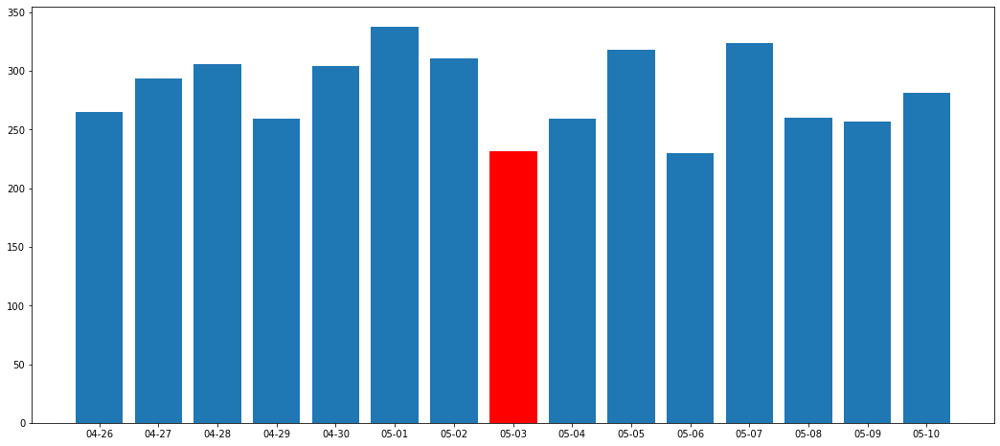

In [95]:
f, ax = plt.subplots(figsize=(18,8)) # set the size that you'd like (width, height)
derecho_chart = plt.bar(derecho_counts['date'], derecho_counts['count'])
derecho_chart[7].set_color('r')

In [ ]:
derecho_counts = before_after_derecho_df.date.value_counts()

In [ ]:
f, ax = plt.subplots(figsize=(18,5)) # set the size that you'd like (width, height)
derecho_chart = plt.bar(before_after_derecho_df['day'], before_after_derecho_df['date'])
derecho_chart[7].set_color('r')

In [ ]:
f, ax = plt.subplots(figsize=(18,5)) # set the size that you'd like (width, height)
derecho_chart = plt.bar(before_after_derecho_df['date'], before_after_derecho_df['count'])
derecho_chart[7].set_color('r')

In [ ]:
cluster_map_police_week_before = folium.Map(location =  [36.1612, -86.7775], zoom_start = 12)

marker_cluster = MarkerCluster().add_to(cluster_map_police_week_before)

folium.GeoJson(zip_codes).add_to(cluster_map_police_week_before)

for row_index, row_values in police_week_before.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values[['incident_occurred', 'incident_location', 'lat', 'lng']])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

    
cluster_map_police_week_before.save('../maps/cluster_map_police_week_before.html')

cluster_map_police_week_before

In [ ]:
tornado = pd.read_csv('../data/tornado.csv')

In [ ]:
tornado_force = ['EF5', 'EF4', 'EF3', 'EF2'] # here I define the strength I want to plot
tornado_lat_low = 36.168 # this is the geographic latitude range
tornado_lat_high = 36.188
#now keep only the records where strength is greater than EF1
tornado = tornado.loc[tornado['EF_Scale'].isin(tornado_force)]
#tornado.shape
#next cell to create map. I concated the two tornado files before this and added a type column showing either 911 call or dispatch. There are a few kinks but it works:
map_tornado = folium.Map(location = [36.173, -86.78], zoom_start = 13.2, tiles = 'Stamen Terrain',
    scrollWheelZoom=False)
    #tiles = 'Stamen Toner' is nice - try 'Stamen Terrain' also 'Mapbox Control Room' 'mapquestopen' 'openstreetmap'
for ind, row in combined_tornado.iterrows():
    # now try to only filter on those within a certain Longitude
    if row['lat'] <tornado_lat_high and row['lat']> tornado_lat_low:
        point = [row['lat'], row['lng']]
        popup = "Type: " + str(row['type'])+" Time:" + str(row['date_time'])+ ' Address:' + str(row['address'])
    # now color format based on the type
        if row['type'] == "911 call":
            folium.CircleMarker(point, radius=10, popup = popup, fill=True, color='green').add_to(map_tornado)
        if row['type'] == "dispatch":
            folium.CircleMarker(point, radius=10, popup = popup, fill=True, color='darkblue').add_to(map_tornado)
        else:
            folium.CircleMarker(point, radius=10, popup = popup,
            color= 'orange', fill=True, fill_color='lightgreen').add_to(map_tornado)
for ind, row in tornado.iterrows():
    point = [row['latitude'], row['longitude']]
    popup = 'Tornado strength ' + str(row['EF_Scale']) + ' at ' + str(row['latitude']) + ": " +str(row['longitude'])
    #now color format based on the strength of the tornado
    if row['EF_Scale']=="EF3":
        folium.Marker(point, popup = popup, icon = folium.Icon(color='darkred', icon='bolt', prefix='fa')).add_to(map_tornado)
    else:
        folium.Marker(point, popup = popup, icon = folium.Icon(color='lightred', icon='bolt', prefix='fa')).add_to(map_tornado)
map_tornado